# Demo notebook

This notebook is to demonstrate the workflow of fetching points of sport facilities and combining that with Helsinki Travel Time Matrix data. This tutorial will walk you through the process of combining the data inputs, visualising them and saving them in tiff format. All functions are defined in the Main_code.py file, refer to that if you want to know how the functions work. In this tutorial, we are using football stadiums (jalkapallostadion in Finnish) as an example, because we can only host so many files in Github. Feel free to download the full data set for [Travel Time Matrix](https://blogs.helsinki.fi/accessibility/helsinki-region-travel-time-matrix-2018/) and visualise the accessibility of any other sports facilities type.

## Fetching sport facility data and combining it to a travel time matrix
**Fetching sport facilities from Lipas-database**

In [1]:
#running functions in Main_code
%run Main_code

In [2]:
#This function asks user which type of sports facilities is the user interested in and fetches the location of those.
#Sports facilities that are type of area or line have been filtered out.

lipas_data = GetLipasUserFriendly()

2 Retkeilyn palvelut
1100 Lähiliikunta ja liikuntapuistot
1200 Yleisurheilukentät ja -paikat
1300 Pallokentät
1600 Golfkentät
2000 Sisäliikuntatilat
2100 Kuntoilukeskukset ja liikuntasalit
2200 Liikuntahallit
2300 Yksittäiset lajikohtaiset sisäliikuntapaikat
2500 Jäähallit
2600 Keilahallit
3000 Vesiliikuntapaikat
3100 Uima-altaat, hallit ja kylpylät
3200 Maauimalat ja uimarannat
4000 Maastoliikuntapaikat
4100 Laskettelurinteet ja rinnehiihtokeskukset
4200 Katetut talviurheilupaikat
4300 Hyppyrimäet
4600 Maastohiihtokeskukset
4700 Kiipeilypaikat
4800 Ampumaurheilupaikat
5100 Veneurheilupaikat
6100 Hevosurheilu
6200 Koiraurheilu
7000 Huoltorakennukset
7000 Huoltorakennus


Anna kyseisen liikuntapaikkatyypin numero 1300



Valitse liikuntapaikkatyyppi
1310 Koripallokenttä
1320 Lentopallokenttä
1330 Beachvolleykenttä
1340 Pallokenttä
1350 Jalkapallostadion
1360 Pesäpallokenttä
1380 Rullakiekkokenttä
1510 Tekojääkenttä
1520 Luistelukenttä
1530 Kaukalo


Liikuntapaikkatyypin koodi 1350



Löysimme seuraavat liikuntapaikat:
0                           Keskusurheilukenttä
1    Tapiolan urheilupuisto / Jalkapallostadion
2    Telia 5G Areena (Töölön jalkapallostadion)
3                    Myyrmäen jalkapallostadion
Name: nimi_fi, dtype: object


In [3]:
#if you already know the type code and type name of the sport facility type you want to fetch, this function can be used instead:
lipas_data = GetLipasData("1350", "jalkapallostadion")



**Combining sports places with travel time data**

Great! Now you have chosen the sports facilities and next, we need it to be combined with the travel time data. The data is in grid format that matches YKR grid, so we will fetch the right travel time files with the YKR id of the cells where the sports places are located in. 

First, a spatial join is made with the YKR grid and the cell ids in which the sports places fall in are saved into a list (with CreateYkrList). 

Next, we fetch the right travel time files from the file structure that is created when you unzip the downloaded Travel Time Matrix into HelsinkiRegionTravelTimeMatrix2018 -folder (with FileFinder). In this tutorial, we are mimicking the file structure under data folder so that the same function works locally on your machine. 

Lastly, YKR and travel time data are joined and the minimum travel times to closest sports facility in question are calculated with 10 different travel methods (with TableJoiner). 

In [4]:
# Makes a spatial join with sports places and YKR grid. Returns a list of YKR cell ids in which the sports places 
#are located in.
ykr_list = CreateYkrList(lipas_data)

# Takes the list of grid cell ids and constructs file paths to match the Travel Time Matrix file structure when unzipped.
filepaths = FileFinder(ykr_list)

# Join travel time files into YKR-grid and create a single geodataframe with minimum travel times
geodata = TableJoiner(filepaths)

# Here you can see how the first five rows of the geodataframe looks
geodata.head()

Processing file data/HelsinkiTravelTimeMatrix2018/5936xxx/travel_times_to_ 5936682.txt. Progress: 1/4
Processing file data/HelsinkiTravelTimeMatrix2018/5967xxx/travel_times_to_ 5967140.txt. Progress: 2/4
Processing file data/HelsinkiTravelTimeMatrix2018/5961xxx/travel_times_to_ 5961882.txt. Progress: 3/4
Processing file data/HelsinkiTravelTimeMatrix2018/5900xxx/travel_times_to_ 5900202.txt. Progress: 4/4


,YKR_ID,min_t_walk,min_t_bike_f,min_t_bike_s,min_t_car_r,min_t_car_m,min_t_car_sl,min_t_pt_r_t,min_t_pt_r_tt,min_t_pt_m_t,min_t_pt_m_tt
0,5785640,293,54,84,40,35,25,104,123,112,143
1,5785641,256,53,83,43,37,25,107,129,110,149
2,5785642,258,53,83,43,37,25,108,134,111,149
3,5785643,262,58,92,43,37,25,113,145,116,149
4,5787544,286,52,81,40,35,24,97,123,105,131


**Saving results to a raster format**

Here we'll produce raster files that will have travel times in minutes to the closest sports facility. The rasters are made to every travel method that the Helsinki Region Travel Time Matrix 2018 data offers, so there will be 10 raster files to match a single sport facility type. The rasters are saved to output folder and can be furter analysed in GIS softwares.

In [35]:
# Saving minimum travel times of each travel method to tiff-raster in output folder
lipascode = "1350"
lipasname = "jalkapallostadion"

GeodataframeToTiff(geodata, lipascode, lipasname)

Files saved.


## Visualizing minimum travel times in a map

**There are 10 different travel types available in Helsinki Region Travel Time Matrix 2018**

More info about the travel times [here](https://blogs.helsinki.fi/accessibility/helsinki-region-travel-time-matrix-2018/)

**Walking**

"min_t_walk" - Minimum travel time in minutes from origin to destination by walking

**Biking**

"min_t_bike_s" - Minimum travel time in minutes from origin to destination by slow cycling; Includes extra time (1 min) that it takes to take/return bike

"min_t_bike_f" - Minimum travel time in minutes from origin to destination by fast cycling; Includes extra time (1 min) that it takes to take/return bike

**Public transport**

"min_t_pt_m_t" - Minimum travel time in minutes from origin to destination by public transportation in midday traffic; whole travel chain has been taken into account excluding the waiting time at home.

"min_t_pt_m_tt" - Minimum travel time in minutes from origin to destination by public transportation in midday traffic; whole travel chain has been taken into acount including the waiting time at home.

"min_t_pt_r_t" - Minimum travel time in minutes from origin to destination by public transportation in rush hour traffic; whole travel chain has been taken into account excluding the waiting time at home.

"min_t_pt_r_tt" - Minimum travel time in minutes from origin to destination by public transportation in rush hour traffic; whole travel chain has been taken into acount including the waiting time at home.

**Car**

"min_t_car_r" - Minimum travel time in minutes from origin to destination by private car in rush hour traffic; the whole travel chain has been taken into account.

"min_t_car_m" - Minimum travel time in minutes from origin to destination by private car in midday traffic; the whole travel chain has been taken into account.

"min_t_car_sl" - Minimum travel time from origin to destination by private car following speed limits without any additional impedances; the whole travel chain has been taken into account 

### Using Visualiser

You can use Visualiser for making a static map file of the accessibility of a sport facility quickly. The map will be saved in output folder as a png-file. 

For this function you need to specify which travel method (above) you want to use. Insert also the name of the sport facility you have fetched from Lipas database earlier, this will be added to the map title. We recommend to add the name in English, since this function has been designed to give map title in English.

'outputs/traveltimesmin_t_bike_f.png'

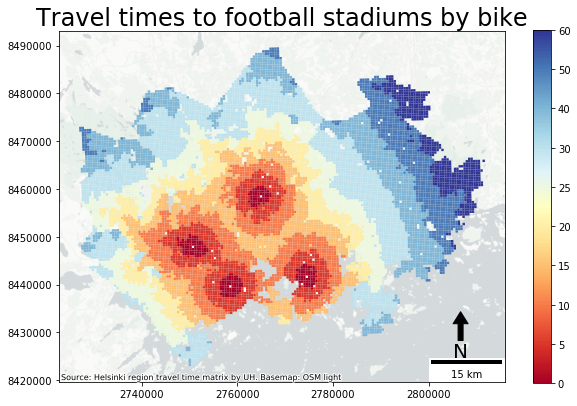

In [40]:
#The Visualiser plots the travel times on a map. First argument is the geodataframe containing the minimum travel times.
#Second argument is the column name you want to visualise (refer to travel types above).
column_name = "min_t_bike_f"
sport_type = "football stadiums"
Visualiser(geodata, column_name, sport_type)

'outputs/traveltimesmin_t_car_m.png'

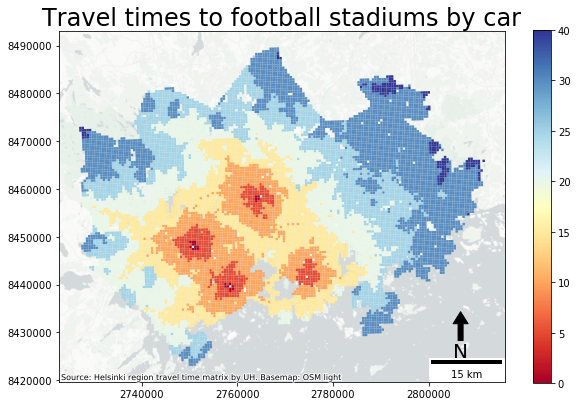

In [22]:
Visualiser(geodata, "min_t_car_m", "football stadiums")

### Using InteractiveMap

You can also make a simple interactive map presentation of the results. The map will be saved in output folder as a html-file.

In [30]:
#This function visualises the travel times on interactive map and takes geodataframe and column name as arguments.
#NB! Does not always work in Chrome browser.
InteractiveMap(geodata, "min_t_pt_r")